## Merging 12 scRNA-seq datasets (part2)
### first round coarse annotation

- 01_all_HNSCC_TIL_Cillo_Immunity_2020_merged_after_batch_correction.h5ad
- 02_PDAC_Peng_J_Cell_Res_2019_merged_after_batch_correction.h5ad
- 03_all_HNSCC_Puram_Cell_2017_merged_after_batch_correction.h5ad
- 04_PDAC_Steele_NCancer_2020_merged_after_batch_correction.h5ad
- 05_LUAD_primary_site_cancer_Kim_NCommun_2020_merged_after_batch_correction.h5ad
- 06_NSCLC_tumor_tissue_Guo_NMed_2018_merged_after_batch_correction.h5ad
- 07_pan_cancer_07_GSE157220_log2cpm1p_filtered.h5ad
- 08_all_PRAD_Cheng_Cell_2021_merged_after_batch_correction.h5ad
- 09_all_PRAD_Commun_Biol_Dong_2020_merged_after_batch_correction.h5ad
- 10_all_HCC_Sun_Cell_2021_merged_after_batch_correction.h5ad
- 11_all_GBM_Neftel_Cell_2019_merged_after_batch_correction.h5ad
- 12_Abdelfattah_GBM_8samples_after_batch_correction.h5ad


In [1]:
import os
import sys
import numpy as np
import pandas as pd
import scanpy as sc
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an
from scipy.sparse import csr_matrix
from deside.utility import check_dir, set_fig_style
from deside.utility import log_exp2cpm, non_log2cpm, log2_transform
sc.settings.set_figure_params(dpi=200)
sns.set()
# set_fig_style(font_family='Arial', font_size=8)

2023-09-26 23:32:53.361430: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-26 23:32:53.530642: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-09-26 23:32:54.109736: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-09-26 23:32:54.109835: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such 

In [2]:
all_dataset = sc.read_h5ad('12datasets_merged_before_batch_correction.h5ad')
all_dataset

AnnData object with n_obs × n_vars = 340235 × 17834
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample_id', 'batch', 'leiden1', 'dataset_id', 'original_cell_type', 'cell_type1', 'leiden'
    var: 'gene_ids', 'n_cells', 'total_counts', 'n_counts'
    uns: 'dataset_id_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

### 5. Batch effect correction by BBKNN
- https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [3]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='dataset_id')

CPU times: user 1min 38s, sys: 3.53 s, total: 1min 42s
Wall time: 1min 33s


In [4]:
%%time
sc.tl.umap(all_dataset, min_dist=0.3)

CPU times: user 54min 18s, sys: 30min 59s, total: 1h 25min 17s
Wall time: 7min 56s


In [5]:
%%time
sc.tl.leiden(all_dataset, resolution=2.5)

CPU times: user 8min 31s, sys: 29.5 s, total: 9min
Wall time: 8min 59s


/home/phyxiongx/.conda/envs/ds/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


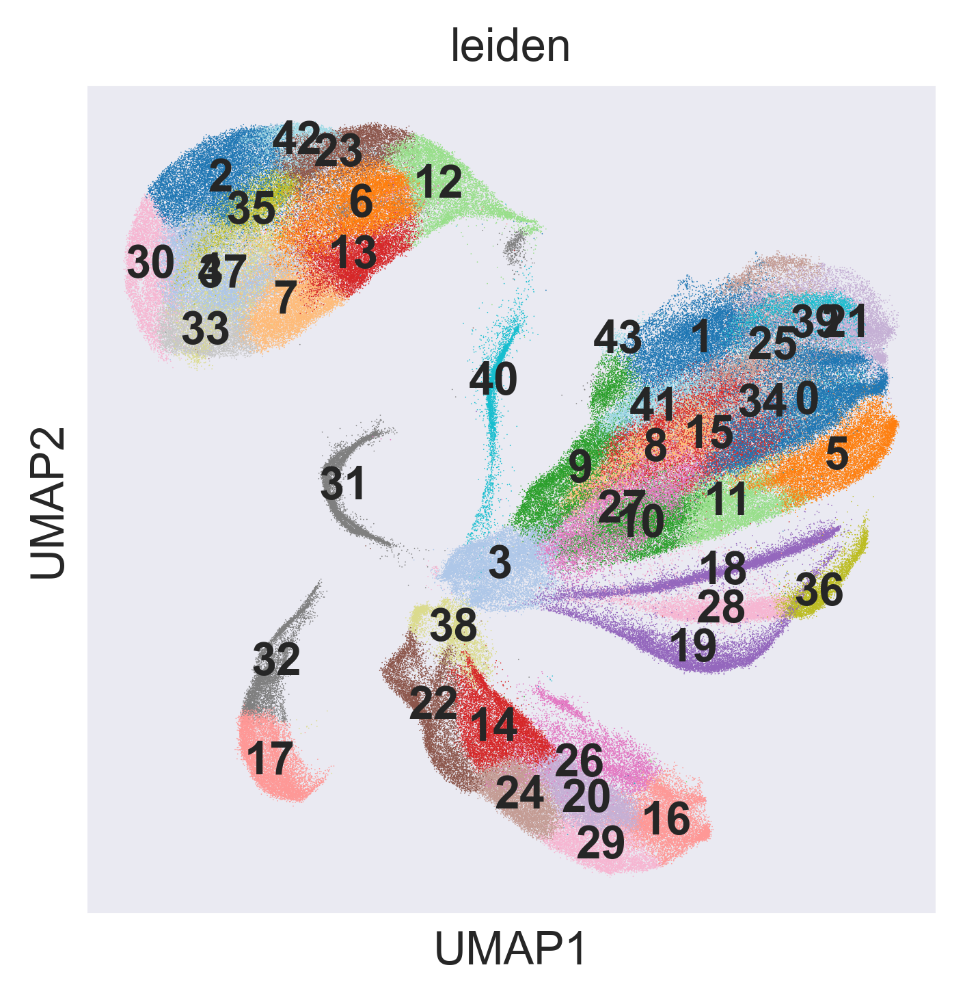

In [6]:
sc._settings.ScanpyConfig.figdir = Path('./fig_merging_12_ds_part2')
sc.pl.umap(all_dataset, color=['leiden'], save='_after_batch_correct_umap_leiden.png', legend_loc='on data', palette='tab20')

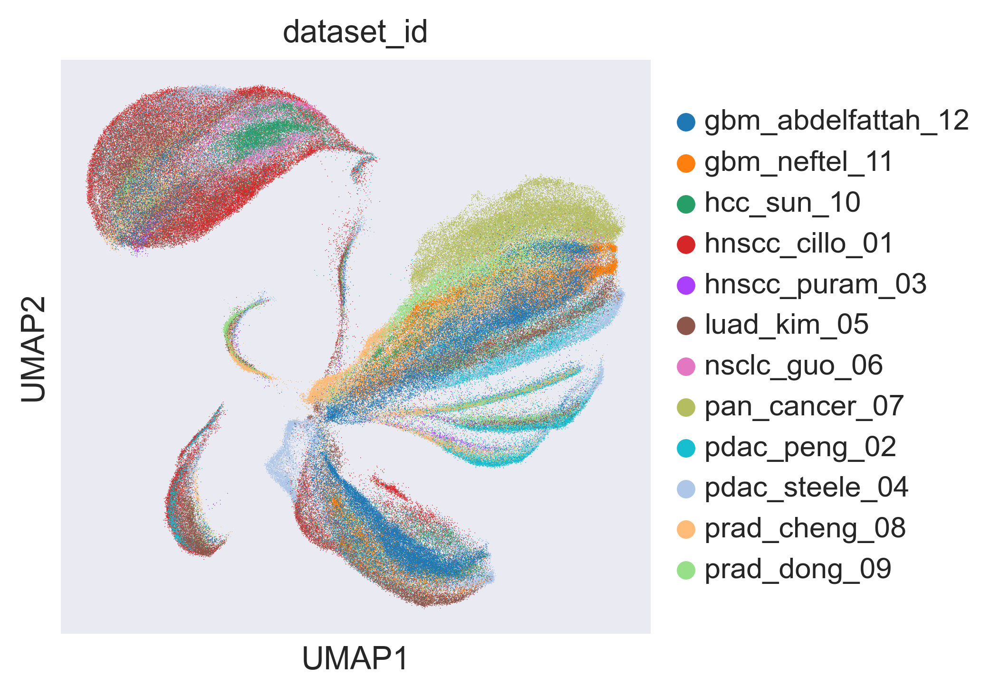

In [7]:
sc.pl.umap(all_dataset, color=['dataset_id'], save='_after_batch_correct_umap_batch_dataset_id.png')

### 6. Finding marker genes

In [8]:
%%time
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')

CPU times: user 22min 15s, sys: 5min 54s, total: 28min 9s
Wall time: 28min 13s


In [9]:
all_dataset.write('12datasets_merged_after_batch_correction.h5ad')

In [10]:
all_dataset = sc.read_h5ad('12datasets_merged_after_batch_correction.h5ad')
all_dataset

AnnData object with n_obs × n_vars = 340235 × 17834
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample_id', 'batch', 'leiden1', 'dataset_id', 'original_cell_type', 'cell_type1', 'leiden'
    var: 'gene_ids', 'n_cells', 'total_counts', 'n_counts'
    uns: 'dataset_id_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [11]:
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False, fontsize=8, ncols=3)

In [12]:
top50 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(50)
top50

,0,1,2,3,4,5,6,7,8,9,...,34,35,36,37,38,39,40,41,42,43
0,GPM6B,HMGA1,RPL34,KLK3,BTG1,KRT19,PTPRC,CCL5,PDLIM5,RPLP0,...,TRPM4,IL32,COL1A2,PTPRC,FTL,KRT17,SSR4,RPS5,TPT1,PRELID1
1,TUBB2B,RPS2,RPL21,KLK2,CXCR4,MUC1,CD3G,NKG7,TRPM4,RPS5,...,KLK4,HLA-A,COL1A1,CXCR4,FTH1,KRT5,MZB1,RPS15,RPL30,RPS2
2,PTPRZ1,PRELID1,RPS27,TFF3,ZFP36L2,KRT7,CD2,GZMA,KLK2,RPL29,...,NKX3-1,B2M,LUM,CD2,TYROBP,GSTP1,FKBP11,RPL36,RPS27,MRPL12
3,PTN,PPP1R14B,EEF1A1,MSMB,SARAF,C19orf33,PTPRCAP,HLA-A,TSPAN1,UQCRQ,...,TMPRSS2,CD3D,DCN,DDX5,SAT1,KRT6A,XBP1,AR,IL7R,SRM
4,TUBA1A,AURKAIP1,RPS15A,AZGP1,CREM,GPRC5A,CCL5,HLA-C,KLK3,RPL8,...,SPDEF,CD2,COL3A1,TSC22D3,S100A9,S100A2,DERL3,TIMM13,RPS29,ATP5G1
5,GPM6A,RPLP0,RPS29,FXYD3,RPL23A,MAL2,GZMA,B2M,TMPRSS2,RPS18,...,TSPAN1,BTG1,COL6A3,TXNIP,AIF1,SFN,HERPUD1,RPS18,RPL37,NME4
6,NOVA1,YBX1,RPLP2,RPS17,RPS3,CLDN4,B2M,TMSB4X,NKX3-1,RPL23,...,PDLIM5,HLA-C,C1S,DNAJB1,CSF3R,PERP,SEC11C,RPS9,RPS21,MRPL41
7,C1orf61,UBE2S,RPS25,TSPAN1,RPL21,EPCAM,ARHGDIB,HCST,H2AFJ,RPS7,...,SORD,S100A4,BGN,IL7R,FCER1G,KRT14,SPCS2,FAM110B,RPS28,NQO2
8,CKB,SRM,LTB,RPL41,HLA-A,SLPI,IL2RG,HLA-B,SPDEF,MARCKSL1,...,MPC2,HLA-B,AEBP1,HLA-E,MNDA,PDLIM1,CD79A,RPL3,RPL13,TUBA1B
9,MAP2,PSMA7,RPS27A,GDF15,CCL5,S100A6,CD3D,CD3D,MPC2,MPC2,...,FOXA1,LTB,COL6A2,CD3G,S100A8,MTRNR2L8,PRDX4,PCSK1N,LTB,UBE2S


In [13]:
n_cluster = top50.shape[1]
top50.to_csv(f'top50genes_for_{n_cluster}clusters.csv')

In [14]:
common_marker_gene = pd.read_csv(r'../marker_genes_subtypes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(474, 4)


,cell_type,subset,PMID,comment
marker_gene,,,,
PRSS1,Acinar cells,Acinar cells,31273297;31924475,NaN
ADAM28,B Cells,Non-plasma B cells,35944503,NaN


In [15]:
genes_in_top50 = {}
for i, row in top50.iterrows():
    for g in row:
        if g not in genes_in_top50:
            genes_in_top50[g] = 1
        else:
            genes_in_top50[g] += 1

In [16]:
common_marker_gene_and_top50 = common_marker_gene.loc[common_marker_gene.index.isin(genes_in_top50.keys()), :].copy()
common_marker_gene_and_top50['n_cluster'] = common_marker_gene_and_top50.index.map(genes_in_top50)
print(common_marker_gene_and_top50.shape)
common_marker_gene_and_top50 = common_marker_gene_and_top50.sort_values(by=['n_cluster', 'cell_type'], ascending=False)
common_marker_gene_and_top50.head(2)

(175, 5)


,cell_type,subset,PMID,comment,n_cluster
marker_gene,,,,,
CD3E,T Cells,T Cells,35944503,NaN,12
CD3D,T Cells,T Cells,35944503,NaN,11


In [17]:
common_marker_gene_and_top50.to_csv(f'common_marker_gene_and_top50_{n_cluster}cluster.csv')

### 7. Cell type annotation

In [18]:
for cluster_id in top50:
    print('Current cluster id: {}'.format(cluster_id))
    print(top50.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(4)])

Current cluster id: 0
        0     cell_type        subset  \
10   SOX2  Glioma Cells  Glioma Cells   
19    NES  Glioma Cells  Glioma Cells   
20  S100B  Glioma Cells  Glioma Cells   
30  NCAM1  NK / Neurons  NK / Neurons   

                                                 PMID  
10                                           35140215  
19                                           35140215  
20                                           35140215  
30  28475900; 31477722;https://en.wikipedia.org/wi...  
Current cluster id: 1
           1         cell_type            subset                  PMID
0      HMGA1  Epithelial Cells  Epithelial Cells  Top correlation gene
3   PPP1R14B    DC (discarded)               pDC  Top correlation gene
4   AURKAIP1  Epithelial Cells  Epithelial Cells  Top correlation gene
15    MRPL12  Epithelial Cells  Epithelial Cells  Top correlation gene
18    CHCHD2  Epithelial Cells  Epithelial Cells  Top correlation gene
28      HDGF  Epithelial Cells  Epithelial C

In [19]:
marker_genes1 = ["CD2", "CD3D", "CD3E", "CD3G", # T Cell
                 "IL7R", # CD4 T / CD8 T (PD-1 high)
                 "CD27", "TIGIT", "CTLA4", "IL2RB", "FOXP3", "PDCD1", "LAG3", "CD244", "TBX21", "CD160", "LAYN", "HAVCR2",  #  CD4 Tregs, CD8 T (PD-1 low) / CD8 Tex | TBX21 (T-bet), PDCD1 (PD1)
                 "LCK", "TCF7", "CCR7", "LTB", "CD4", "IL2RG", "TNFRSF4", "CREM",  # CD4 T helpers / Tconv
                 "CD7", "CD8A", "CD8B", "GZMA", "CD96", "LAG3", "GZMH", "GNLY", # CD8 T
                 "CCL5", "NKG7", "PRF1",  # NK / CD8 Tconv
                 "NCAM1", "KLRD1", "SAMD3", "CD247", "CTSW",   # NK
                 "KRT19", "KRT18", "KRT8" ] #   Epithelial Cells

/home/phyxiongx/.conda/envs/ds/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


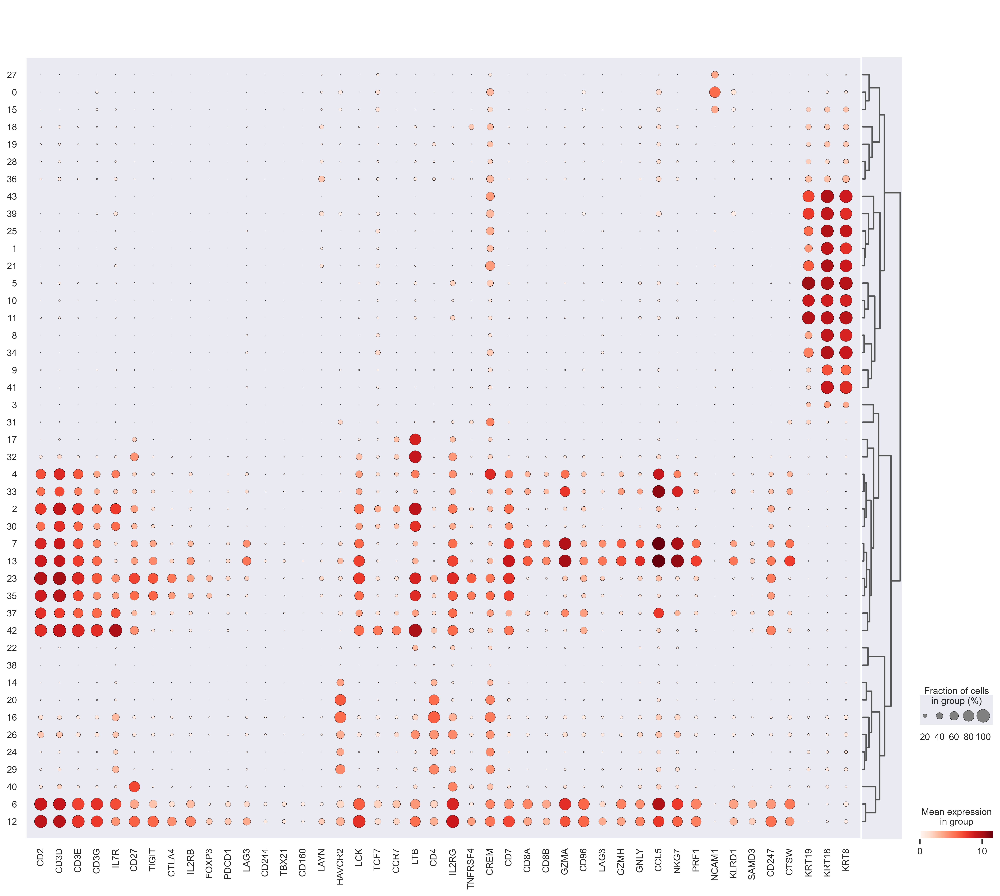

In [20]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

In [21]:
marker_genes2 = ["CD79A", "CD79B", "FCRLA", # B Cells
                 "MS4A1", "VPREB3", # Non-plasma B Cells
                 "DERL3", "FKBP11", "MZB1",  # Plasma B cells
                 "CD83", "IRF8", "PPP1R14B", "CPVL", # DC
                 "CLEC14A", "CLDN5", "PLVAP", "VWF", # Endothelial Cells
                 "COL6A2", "COL1A1", "COL1A2", "COL3A1", # Fibroblasts
                 "MMP2", # CAFs
                 "MYL9", "MYLK", # Myofibroblasts
                 "HLA-DRA", "CD14", # Macrophages / DC
                 "LYZ", "MARCO", "MS4A7", "FCGR3A", # Macrophages
                 "SOD2", "CCL3", "CD163", "MS4A4A", "TREM2", "GPNMB", # M1 / M2
                 "TPSAB1", # Mast Cells
                 "CYBB", "CSF1R", "CTSS", "MS4A6A", # Monocytes / Macrophages
                 "FCGR3B", "CSF3R", "FPR1", "S100A8", "S100A9"]  # Neutrophils

/home/phyxiongx/.conda/envs/ds/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


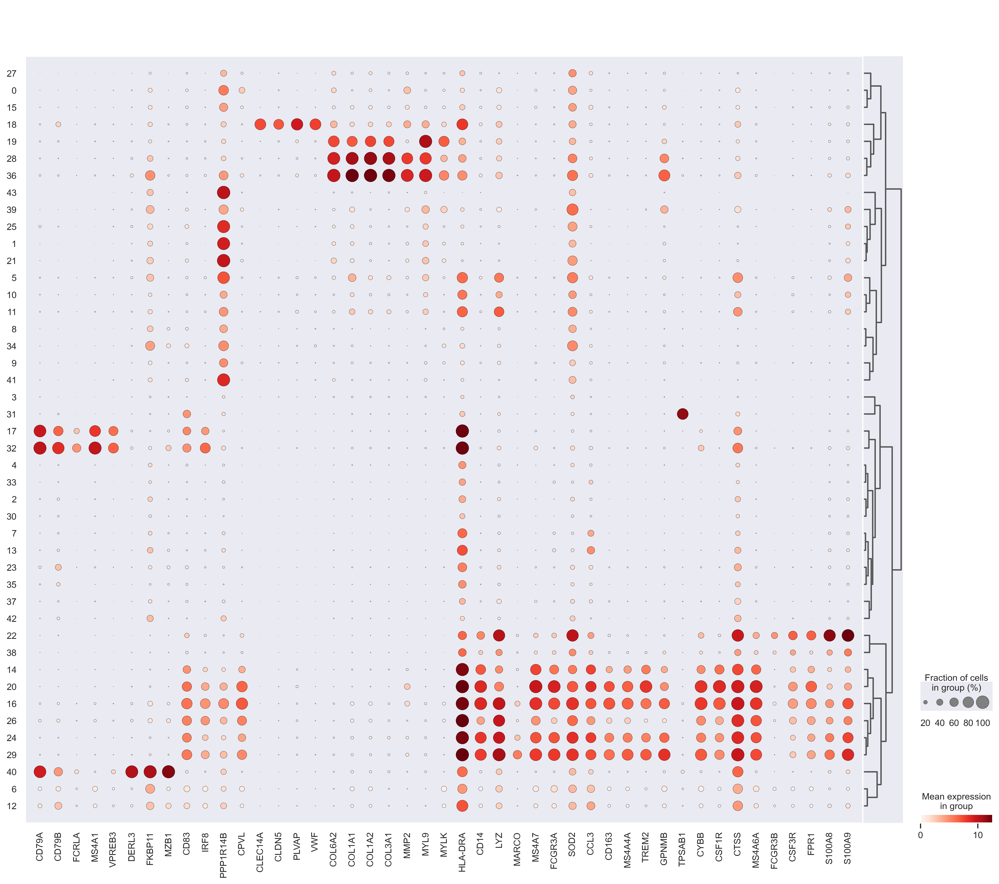

In [22]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)

In [24]:
# first round coarse annotation
new_cluster_names = {
    0: 'Glioma Cells (1)',
    1: 'Epithelial Cells (1)',
    2: 'CD4 T (1)',  # LTBc
    3: 'Epithelial Cells (2)',
    4: 'CD8 T (1)',  # CCL5
    5: 'Epithelial Cells (3)',
    6: 'CD8 T (2)',  # CCL5 / GZMA / NKG7 /CD96 / CD8A
    7: 'CD8 T / NK (1)', # NKG7
    8: 'Epithelial Cells (4)',
    9: 'Epithelial Cells (5)', 
    10: 'Epithelial Cells (6)',
    11: 'Epithelial Cells (7)',
    12: 'CD8 T (3)',  # TIGIT
    13: 'CD8 T / NK (2)',  # NKG7
    14: 'Macrophages (1)',
    15: 'Glioma Cells (2)',
    16: 'Macrophages (2)',  # CD163
    17: 'Non-plasma B cells (1)',  # MS4A1
    18: 'Endothelial Cells',
    19: 'Myofibroblasts',  # MYL9
    20: 'Macrophages (3)',  # TREM2
    21: 'Epithelial Cells (8)', # 
    22: 'Neutrophils (1)',  # low CD14 / low MS4A7
    23: 'CD4 T (2)',  # CD27 / LTB / CTLA4, w/o CD8T, low CCR7, low TCF7, 
    24: 'Macrophages (4)',
    25: 'Epithelial Cells (9)',
    26: 'DC', # HLA-DRA
    27: 'Glioma Cells (3)',
    28: 'CAFs (1)',  # MMP2
    29: 'Macrophages (5)',  # GPNMB
    30: 'CD4 T (3)',
    31: 'Mast Cells',
    32: 'Non-plasma B cells (2)',  # MS4A1
    33: 'CD8 T / NK (3)',  # NKG7 w/o CD8A 
    34: '34',
    35: 'CD4 T (4)',
    36: 'CAFs (2)',  # MMP2
    37: 'CD8 T (4)',  # CCL5, GZMA/K
    38: 'Neutrophils (2)',  # low CD14 / low MS4A7
    39: 'Epithelial Cells (10)',
    40: 'Plasma B cells',  # MZB1
    41: '41',
    42: 'CD4 T (5)',  # IL7R
    43: 'Epithelial Cells (11)',
    
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['Glioma Cells (1)', 'Epithelial Cells (1)', 'CD4 T (1)', 'Epithelial Cells (2)', 'CD8 T (1)', 'Epithelial Cells (3)', 'CD8 T (2)', 'CD8 T / NK (1)', 'Epithelial Cells (4)', 'Epithelial Cells (5)', 'Epithelial Cells (6)', 'Epithelial Cells (7)', 'CD8 T (3)', 'CD8 T / NK (2)', 'Macrophages (1)', 'Glioma Cells (2)', 'Macrophages (2)', 'Non-plasma B cells (1)', 'Endothelial Cells', 'Myofibroblasts', 'Macrophages (3)', 'Epithelial Cells (8)', 'Neutrophils (1)', 'CD4 T (2)', 'Macrophages (4)', 'Epithelial Cells (9)', 'DC', 'Glioma Cells (3)', 'CAFs (1)', 'Macrophages (5)', 'CD4 T (3)', 'Mast Cells', 'Non-plasma B cells (2)', 'CD8 T / NK (3)', '34', 'CD4 T (4)', 'CAFs (2)', 'CD8 T (4)', 'Neutrophils (2)', 'Epithelial Cells (10)', 'Plasma B cells', '41', 'CD4 T (5)', 'Epithelial Cells (11)']


/home/phyxiongx/.conda/envs/ds/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


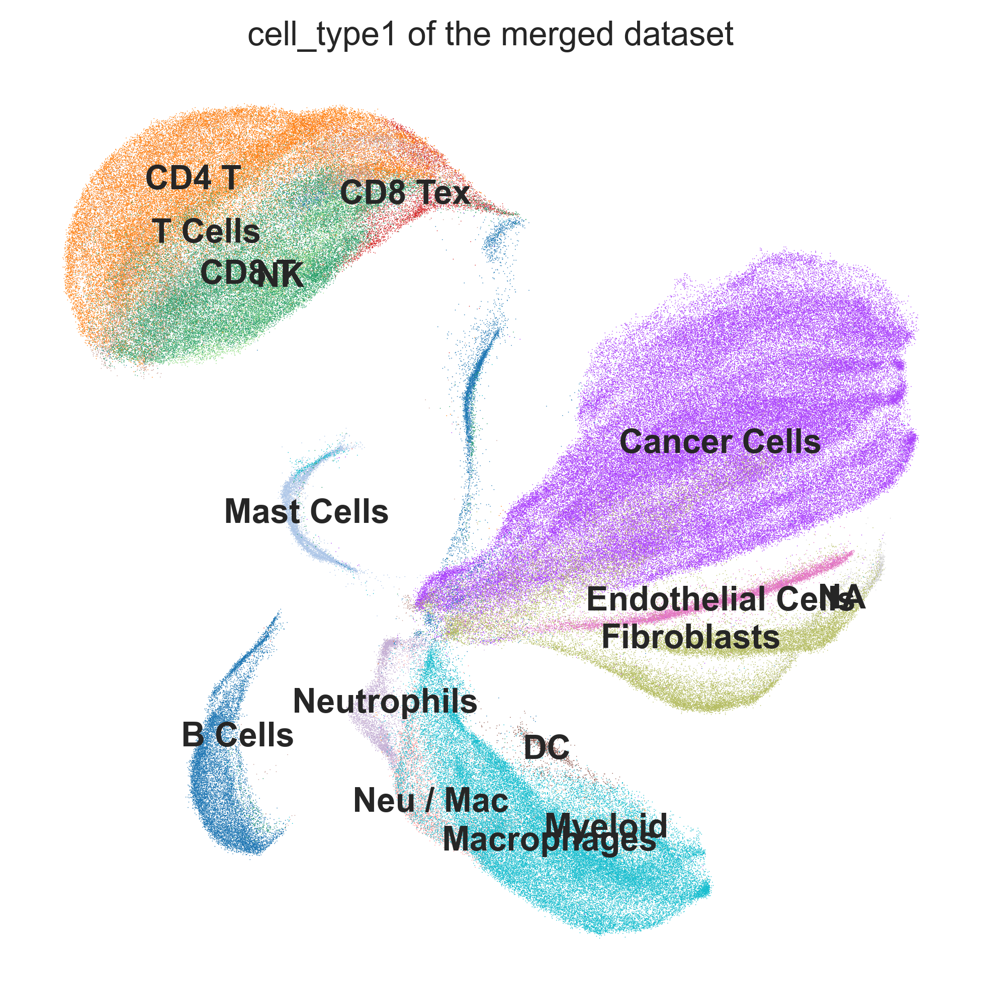

In [25]:
rcParams['figure.figsize'] = 6, 6
sc.pl.umap(all_dataset, color='cell_type1', legend_loc='on data', legend_fontsize='medium', title='cell_type1 of the merged dataset', frameon=False, save='_merged_cell_type1.png')

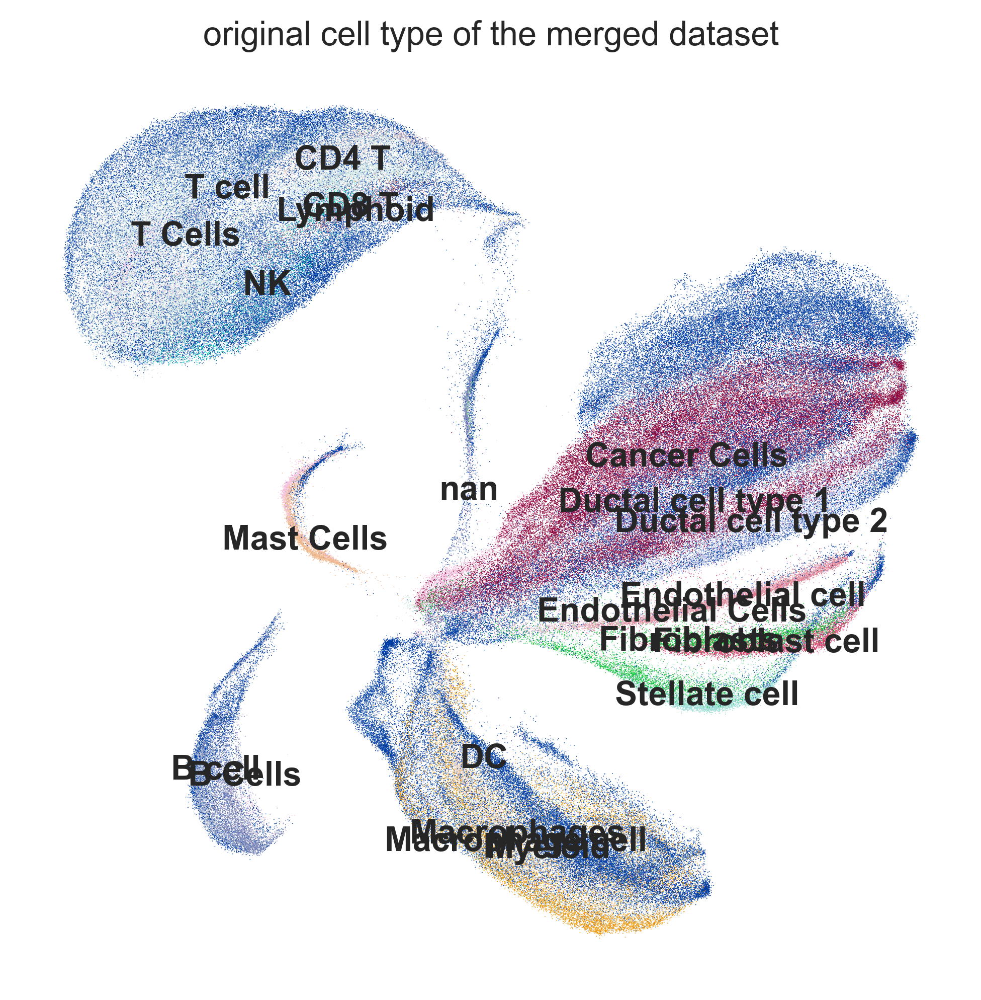

In [26]:
sc.pl.umap(all_dataset, color='original_cell_type', legend_loc='on data', legend_fontsize='medium', title='original cell type of the merged dataset', frameon=False, save='_merged_original_cell_type.png')

In [30]:
leiden2subtype = {
 '34'                     : '-',
 '41'                     : '-',
 'CAFs (1)'               : 'CAFs',
 'CAFs (2)'               : 'CAFs',
 'CD4 T (1)'              : 'CD4 T',
 'CD4 T (2)'              : 'CD4 T',
 'CD4 T (3)'              : 'CD4 T',
 'CD4 T (4)'              : 'CD4 T',
 'CD4 T (5)'              : 'CD4 T',
 'CD8 T (1)'              : 'CD8 T',
 'CD8 T (2)'              : 'CD8 T',
 'CD8 T (3)'              : 'CD8 T',
 'CD8 T (4)'              : 'CD8 T',
 'DC'                     : 'DC',
 'Endothelial Cells'      : 'Endothelial Cells',
 'Epithelial Cells (1)'   : 'Epithelial Cells',
 'Epithelial Cells (10)'  : 'Epithelial Cells',
 'Epithelial Cells (11)'  : 'Epithelial Cells',
 'Epithelial Cells (2)'   : 'Epithelial Cells',
 'Epithelial Cells (3)'   : 'Epithelial Cells',
 'Epithelial Cells (4)'   : 'Epithelial Cells',
 'Epithelial Cells (5)'   : 'Epithelial Cells',
 'Epithelial Cells (6)'   : 'Epithelial Cells',
 'Epithelial Cells (7)'   : 'Epithelial Cells',
 'Epithelial Cells (8)'   : 'Epithelial Cells',
 'Epithelial Cells (9)'   : 'Epithelial Cells',
 'Glioma Cells (1)'       : 'Glioma Cells',
 'Glioma Cells (2)'       : 'Glioma Cells',
 'Glioma Cells (3)'       : 'Glioma Cells',
 'Macrophages (1)'        : 'Macrophages',
 'Macrophages (2)'        : 'Macrophages',
 'Macrophages (3)'        : 'Macrophages',
 'Macrophages (4)'        : 'Macrophages',
 'Macrophages (5)'        : 'Macrophages',
 'Mast Cells'             : 'Mast Cells',
 'Myofibroblasts'         : 'Myofibroblasts',
 'CD8 T / NK (1)'         : 'CD8 T / NK',
 'CD8 T / NK (2)'         : 'CD8 T / NK',
 'CD8 T / NK (3)'         : 'CD8 T / NK',
 'Neutrophils (1)'        : 'Neutrophils',
 'Neutrophils (2)'        : 'Neutrophils',
 'Non-plasma B cells (1)' : 'Non-plasma B cells',
 'Non-plasma B cells (2)' : 'Non-plasma B cells',
 'Plasma B cells'         : 'Plasma B cells',
}
all_dataset.obs['cell_type_first_round'] = all_dataset.obs.leiden.map(leiden2subtype)
all_dataset.obs.head(2)

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sample_id,batch,leiden1,dataset_id,original_cell_type,cell_type1,leiden,cell_type_first_round
AAACCTGAGCTGTCTA-1_HNSCC_1_TIL,2061,2044,9899.0,314.0,3.172038,hnscc_cillo_01_HNSCC_1_TIL,0,CD8 Tex,hnscc_cillo_01,,CD8 Tex,CD4 T (2),CD4 T
AAACCTGCAGCTGCTG-1_HNSCC_1_TIL,1261,1256,4692.0,118.0,2.514919,hnscc_cillo_01_HNSCC_1_TIL,0,CD4 T (3),hnscc_cillo_01,,CD4 T,CD4 T (1),CD4 T


/home/phyxiongx/.conda/envs/ds/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


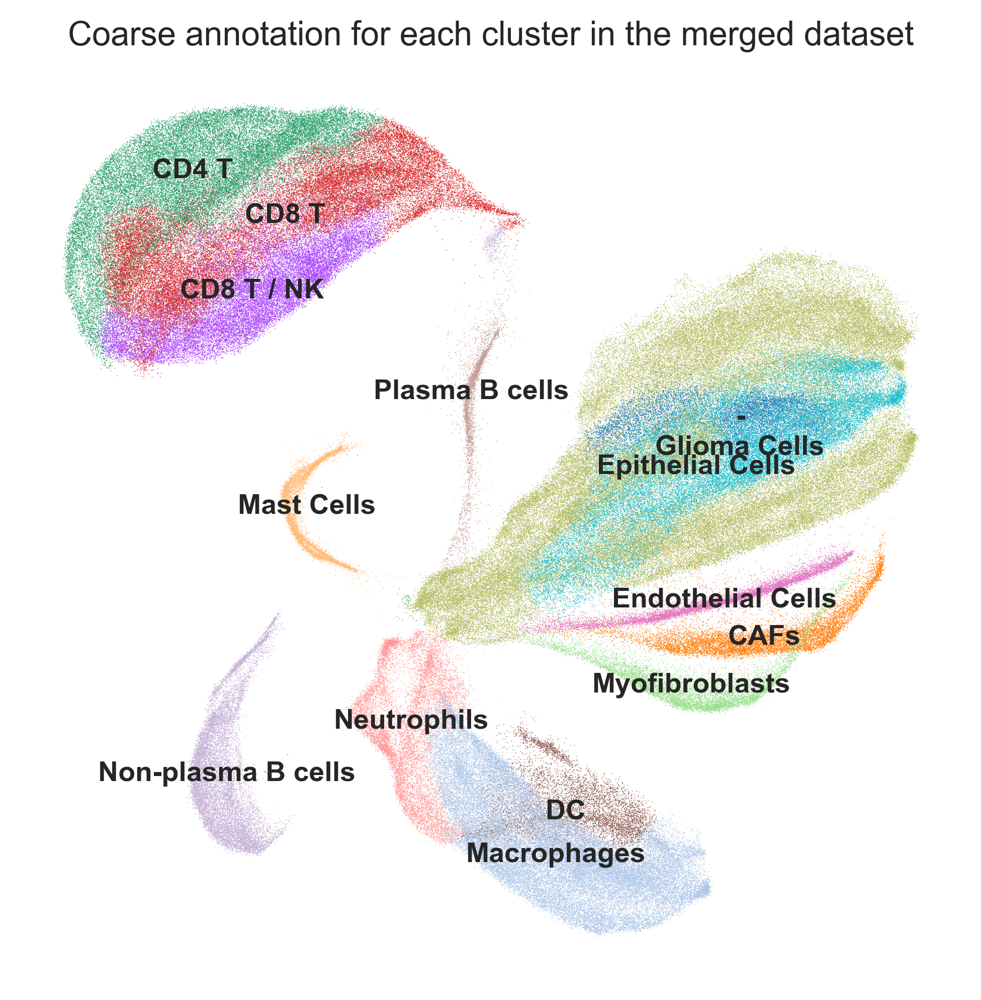

In [31]:
sc.pl.umap(all_dataset, color='cell_type_first_round', legend_loc='on data', legend_fontsize='small', title='Coarse annotation for each cluster in the merged dataset', frameon=False, save='_merged_leiden_coarse_annotation.png')

In [32]:
all_dataset.obs.groupby('cell_type_first_round').size()

cell_type_first_round
-                      9153
CAFs                  10596
CD4 T                 33915
CD8 T                 35313
CD8 T / NK            25364
DC                     7548
Endothelial Cells      8489
Epithelial Cells      95209
Glioma Cells          29855
Macrophages           39879
Mast Cells             6126
Myofibroblasts         8455
Neutrophils           11963
Non-plasma B cells    14591
Plasma B cells         3779
dtype: int64

In [33]:
all_dataset = all_dataset[all_dataset.obs['cell_type_first_round'] != '-', :].copy()
all_dataset

AnnData object with n_obs × n_vars = 331082 × 17834
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sample_id', 'batch', 'leiden1', 'dataset_id', 'original_cell_type', 'cell_type1', 'leiden', 'cell_type_first_round'
    var: 'gene_ids', 'n_cells', 'total_counts', 'n_counts'
    uns: 'dataset_id_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'dendrogram_leiden', 'cell_type1_colors', 'original_cell_type_colors', 'cell_type_first_round_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [34]:
all_dataset.write('12datasets_merged_after_batch_correction_coarse_annotation.h5ad', compression='gzip')